In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
# read the dataset and display table information
df_22 = pd.read_csv('../data/clean/cleaned_df_22.csv')

In [3]:
display(df_22, df_22.info(), df_22.nunique())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38159 entries, 0 to 38158
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   country           38159 non-null  object 
 1   age_range         38159 non-null  object 
 2   employment        38159 non-null  object 
 3   work_location     38159 non-null  object 
 4   education_level   38159 non-null  object 
 5   years_coding      38159 non-null  float64
 6   years_coding_pro  38159 non-null  float64
 7   type              38159 non-null  object 
 8   currency          38159 non-null  object 
 9   salary            38159 non-null  float64
dtypes: float64(3), object(7)
memory usage: 2.9+ MB


,country,age_range,employment,work_location,education_level,years_coding,years_coding_pro,type,currency,salary
0,United Kingdom of Great Britain and Northern I...,25-34 years old,"Employed, full-time",Hybrid,Master Degree,14.0,5.0,Front-End Developer,GBP,32000.0
1,Other,35-44 years old,"Employed, full-time",Fully remote,Bachelor Degree,20.0,17.0,Other,ILS,60000.0
2,Netherlands,25-34 years old,"Employed, full-time",Hybrid,Master Degree,6.0,6.0,Other,EUR,46000.0
3,United Kingdom of Great Britain and Northern I...,18-24 years old,"Employed, full-time",Hybrid,Bachelor Degree,5.0,2.0,Full Stack Developer,GBP,48000.0
4,United States of America,35-44 years old,Freelancer/Contractor,Fully remote,Bachelor Degree,12.0,10.0,Other,USD,194400.0
...,...,...,...,...,...,...,...,...,...,...
38154,Poland,25-34 years old,"Employed, full-time",Hybrid,Master Degree,6.0,2.0,Other,PLN,8000.0
38155,France,18-24 years old,"Employed, full-time",Hybrid,Master Degree,9.0,2.0,Other,EUR,36000.0
38156,Other,25-34 years old,"Employed, full-time",Fully remote,Bachelor Degree,8.0,5.0,Other,USD,60000.0
38157,United States of America,25-34 years old,"Employed, full-time",Full in-person,Master Degree,6.0,5.0,Specialist,USD,107000.0


None

country               18
age_range              6
employment             3
work_location          3
education_level        5
years_coding          50
years_coding_pro      50
type                   9
currency              38
salary              3161
dtype: int64

In [4]:
#standardise currency to EUR

In [5]:
print(df_22['currency'].value_counts())

currency
USD      10079
EUR       9863
GBP       2681
INR       2167
Other     1760
CAD       1481
BRL       1183
PLN        896
AUD        843
SEK        657
CHF        524
RUB        494
ILS        389
TRY        358
CZK        339
DKK        330
NOK        318
MXN        292
NZD        281
ZAR        275
PKR        256
IRR        252
RON        223
HUF        211
BDT        197
JPY        190
COP        182
ARS        180
BGN        167
IDR        161
CNY        154
UAH        126
PHP        112
CLP        112
KRW        109
EGP        106
NGN        106
SGD        105
Name: count, dtype: int64


In [6]:
# Exchange rates to EUR
exchange_rates = {
    'EUR': 1.00,
    'USD': 0.92,
    'GBP': 1.16,
    'INR': 0.011,
    'CAD': 0.67,
    'UAH': 0.025,
    'BRL': 0.18,
    'PLN': 0.21,
    'AUD': 0.59,
    'SEK': 0.086,
    'CHF': 1.04,
    'CZK': 0.041,
    'RUB': 0.0095,
    'DKK': 0.13,
    'NOK': 0.087,
    'ILS': 0.24,
    'NZD': 0.55,
    'ZAR': 0.049,
    'MXN': 0.052,
    'TRY': 0.034,
    'HUF': 0.0026,
    'RON': 0.20,
    'PKR': 0.0032,
    'BGN': 0.51,
    'IRR': 0.000022,
    'JPY': 0.0063,
    'BDT': 0.0086,
    'TWD': 0.029,
    'IDR': 0.000061,
    'COP': 0.00022,
    'CNY': 0.13
}

other_exchange_rates = {
    'NGN': 0.0012,
    'SGD': 0.64,
    'KRW': 0.0007,
    'VND': 0.000039,
    'ARS': 0.0026,
    'CLP': 0.0011,
    'HKD': 0.12,
    'AED': 0.25,
    'LKR': 0.0028,
    'PHP': 0.017,
    'RSD': 0.0085,
    'MYR': 0.21,
    'EGP': 0.029,
    'THB': 0.026,
    'KES': 0.0065,
    'NPR': 0.0071,
    'GEL': 0.35,
    'MAD': 0.090,
    'KZT': 0.002,
    'PEN': 0.23,
    'TND': 0.30,
    'UYU': 0.022,
    'AMD': 0.0018,
    'BAM': 0.51,
    'SAR': 0.25,
    'DOP': 0.016,
    'GHS': 0.079,
    'XOF': 0.0015,
    'PYG': 0.00014,
    'ETB': 0.017,
    'BOB': 0.13,
    'GTQ': 0.12,
    'UZS': 0.000079,
    'BYN': 0.37,
    'JOD': 1.29,
    'ISK': 0.0071,
    'AFN': 0.011,
    'CRC': 0.0017,
    'AZN': 0.53,
    'DZD': 0.0068,
    'MKD': 0.016,
    'MDL': 0.052,
    'IQD': 0.00063,
    'TZS': 0.00037,
    'UGX': 0.00024,
    'KGS': 0.010,
    'ALL': 0.0093,
    'MVR': 0.058,
    'MUR': 0.020,
    'RWF': 0.00080,
    'XAF': 0.0015,
    'HNL': 0.038,
    'FJD': 0.42,
    'SYP': 0.00040,
    'MGA': 0.00020,
    'TMT': 0.27,
    'ZMW': 0.048,
    'MMK': 0.00044,
    'BHD': 2.44,
    'JMD': 0.0060,
    'QAR': 0.25,
    'AOA': 0.0011,
    'TTD': 0.14,
    'MNT': 0.00027,
    'MWK': 0.00080,
    'MZN': 0.014,
    'NIO': 0.025,
    'KWD': 3.04,
    'XPF': 0.0084,
    'OMR': 2.40,
    'YER': 0.0037,
    'VES': 0.000025,
    'GGP': 1.16,
    'ANG': 0.51,
    'NAD': 0.049,
    'BTN': 0.011,
    'MOP': 0.11,
    'BIF': 0.00035,
    'KHR': 0.00022,
    'CUP': 0.036,
    'TJS': 0.083,
    'MRU': 0.024,
    'CVE': 0.0091,
    'SRD': 0.025,
    'SZL': 0.049,
    'BWP': 0.069,
    'FKP': 1.16,
    'BND': 0.64,
    'WST': 0.34,
    'IMP': 1.16,
    'XDR': 1.29,
    'SOS': 0.0016,
    'LBP': 0.00006,
    'BSD': 0.92,
    'LYD': 0.19,
    'SLL': 0.000043,
    'GYD': 0.0044,
    'KPW': 0.00092,
    'AWG': 0.51
}
other_median_rate = pd.Series(list(other_exchange_rates.values())).median()

# Apply the conversion to EUR for each row
df_22['salary_eur'] = df_22.apply(lambda row: row['salary'] * exchange_rates.get(row['currency'], other_median_rate if row['currency'] == 'Other' else exchange_rates.get(row['currency'], 1)), axis=1)

# Verify the new column
df_22[['currency', 'salary', 'salary_eur']].tail(30)

,currency,salary,salary_eur
38129,USD,3000.0,2760.0
38130,USD,120000.0,110400.0
38131,USD,67000.0,61640.0
38132,USD,165000.0,151800.0
38133,BRL,55000.0,9900.0
38134,CZK,130000.0,5330.0
38135,USD,210000.0,193200.0
38136,EUR,60000.0,60000.0
38137,USD,300000.0,276000.0
38138,USD,200000.0,184000.0


In [7]:
print(df_22['currency'].value_counts())

currency
USD      10079
EUR       9863
GBP       2681
INR       2167
Other     1760
CAD       1481
BRL       1183
PLN        896
AUD        843
SEK        657
CHF        524
RUB        494
ILS        389
TRY        358
CZK        339
DKK        330
NOK        318
MXN        292
NZD        281
ZAR        275
PKR        256
IRR        252
RON        223
HUF        211
BDT        197
JPY        190
COP        182
ARS        180
BGN        167
IDR        161
CNY        154
UAH        126
PHP        112
CLP        112
KRW        109
EGP        106
NGN        106
SGD        105
Name: count, dtype: int64


In [8]:
display(df_22)

,country,age_range,employment,work_location,education_level,years_coding,years_coding_pro,type,currency,salary,salary_eur
0,United Kingdom of Great Britain and Northern I...,25-34 years old,"Employed, full-time",Hybrid,Master Degree,14.0,5.0,Front-End Developer,GBP,32000.0,37120.0
1,Other,35-44 years old,"Employed, full-time",Fully remote,Bachelor Degree,20.0,17.0,Other,ILS,60000.0,14400.0
2,Netherlands,25-34 years old,"Employed, full-time",Hybrid,Master Degree,6.0,6.0,Other,EUR,46000.0,46000.0
3,United Kingdom of Great Britain and Northern I...,18-24 years old,"Employed, full-time",Hybrid,Bachelor Degree,5.0,2.0,Full Stack Developer,GBP,48000.0,55680.0
4,United States of America,35-44 years old,Freelancer/Contractor,Fully remote,Bachelor Degree,12.0,10.0,Other,USD,194400.0,178848.0
...,...,...,...,...,...,...,...,...,...,...,...
38154,Poland,25-34 years old,"Employed, full-time",Hybrid,Master Degree,6.0,2.0,Other,PLN,8000.0,1680.0
38155,France,18-24 years old,"Employed, full-time",Hybrid,Master Degree,9.0,2.0,Other,EUR,36000.0,36000.0
38156,Other,25-34 years old,"Employed, full-time",Fully remote,Bachelor Degree,8.0,5.0,Other,USD,60000.0,55200.0
38157,United States of America,25-34 years old,"Employed, full-time",Full in-person,Master Degree,6.0,5.0,Specialist,USD,107000.0,98440.0


In [9]:
print(df_22['country'].value_counts())

country
Other                                                   10435
United States of America                                 8687
Germany                                                  2911
United Kingdom of Great Britain and Northern Ireland     2647
India                                                    2216
Canada                                                   1485
France                                                   1384
Brazil                                                   1286
Spain                                                     998
Poland                                                    980
Netherlands                                               903
Australia                                                 835
Italy                                                     813
Sweden                                                    665
Russian Federation                                        536
Switzerland                                               519


In [10]:
# Rename specific country values for simplificity
df_22['country'] = df_22['country'].replace({
    'United States of America': 'United States',
    'United Kingdom of Great Britain and Northern Ireland': 'United Kingdom'
})
print(df_22['country'].value_counts())

country
Other                 10435
United States          8687
Germany                2911
United Kingdom         2647
India                  2216
Canada                 1485
France                 1384
Brazil                 1286
Spain                   998
Poland                  980
Netherlands             903
Australia               835
Italy                   813
Sweden                  665
Russian Federation      536
Switzerland             519
Turkey                  443
Austria                 416
Name: count, dtype: int64


# viewing

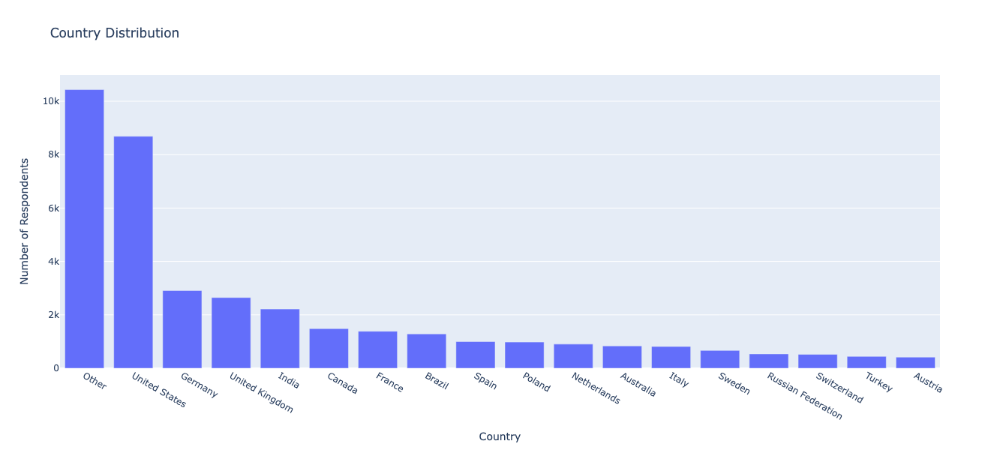

In [11]:
# Get the value counts for the 'country' column
country_distribution = df_22['country'].value_counts().reset_index()
country_distribution.columns = ['country', 'count']

# Create a bar chart for country distribution
fig = px.bar(country_distribution, x='country', y='count', 
             title='Country Distribution',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis={'categoryorder':'total descending'}, xaxis_title='Country', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

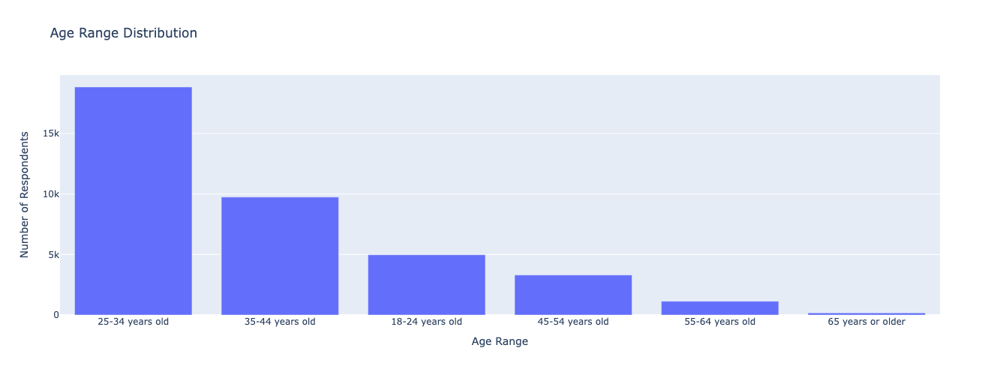

In [12]:
# Get the value counts for the 'age_range' column
age_range_distribution = df_22['age_range'].value_counts().reset_index()
age_range_distribution.columns = ['age_range', 'count']

# Create a bar chart for age range distribution
fig = px.bar(age_range_distribution, x='age_range', y='count', 
             title='Age Range Distribution',
             labels={'count': 'Number of Respondents', 'age_range': 'Age Range'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Age Range', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

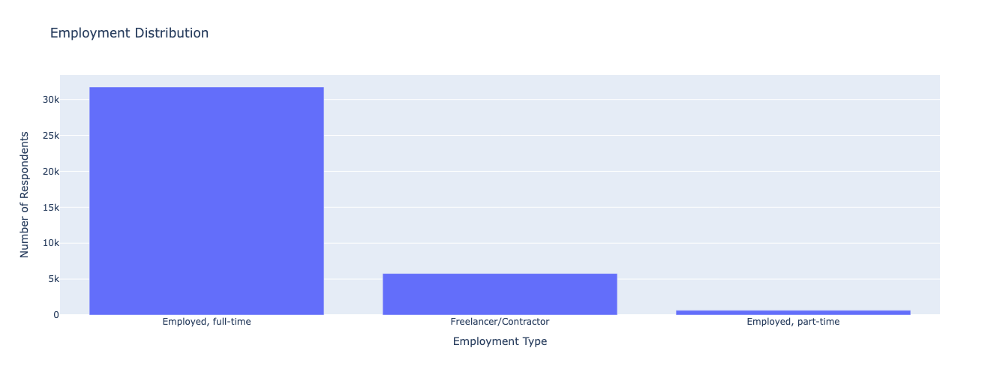

In [13]:
# Get the value counts for the 'employment' column
employment_distribution = df_22['employment'].value_counts().reset_index()
employment_distribution.columns = ['employment', 'count']

# Create a bar chart for employment distribution
fig = px.bar(employment_distribution, x='employment', y='count', 
             title='Employment Distribution',
             labels={'count': 'Number of Respondents', 'employment': 'Employment Type'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Employment Type', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

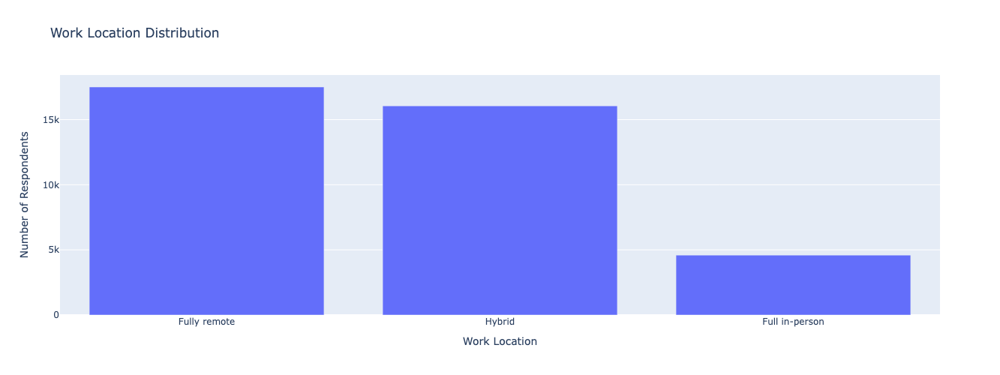

In [14]:
# Get the value counts for the 'work_location' column
work_location_distribution = df_22['work_location'].value_counts().reset_index()
work_location_distribution.columns = ['work_location', 'count']

# Create a bar chart for work location distribution
fig = px.bar(work_location_distribution, x='work_location', y='count', 
             title='Work Location Distribution',
             labels={'count': 'Number of Respondents', 'work_location': 'Work Location'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Work Location', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

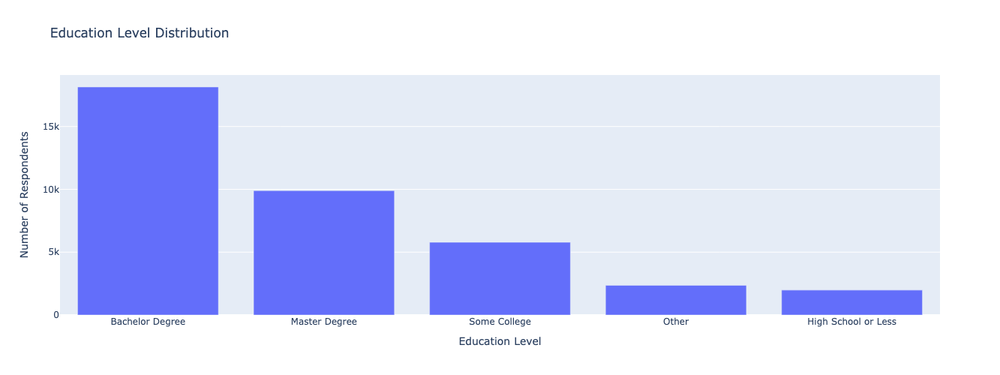

In [15]:
# Get the value counts for the 'education_level' column
education_level_distribution = df_22['education_level'].value_counts().reset_index()
education_level_distribution.columns = ['education_level', 'count']

# Create a bar chart for education level distribution
fig = px.bar(education_level_distribution, x='education_level', y='count', 
             title='Education Level Distribution',
             labels={'count': 'Number of Respondents', 'education_level': 'Education Level'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Education Level', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

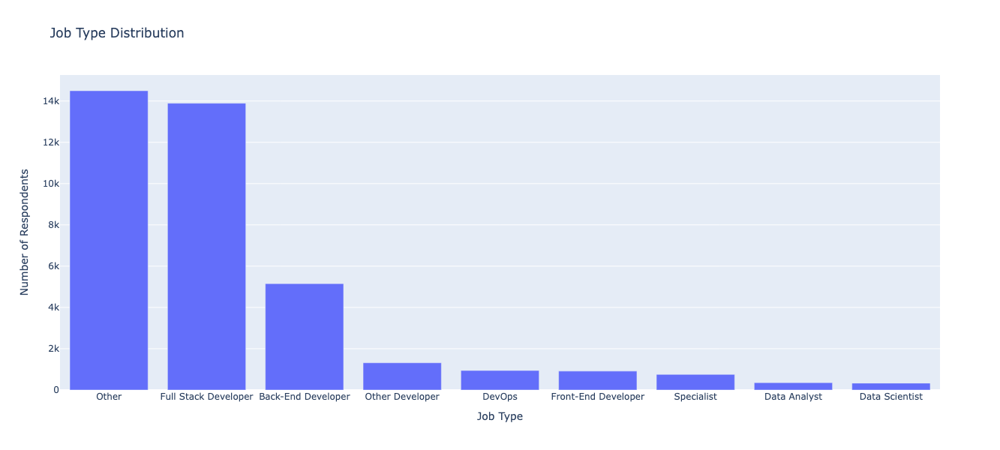

In [16]:
# Get the value counts for the 'type' column
type_distribution = df_22['type'].value_counts().reset_index()
type_distribution.columns = ['type', 'count']

# Create a bar chart for type distribution
fig = px.bar(type_distribution, x='type', y='count', 
             title='Job Type Distribution',
             labels={'count': 'Number of Respondents', 'type': 'Job Type'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis_title='Job Type', yaxis_title='Number of Respondents', 
                  xaxis={'categoryorder':'total descending'})

# Display the plot
fig.show()

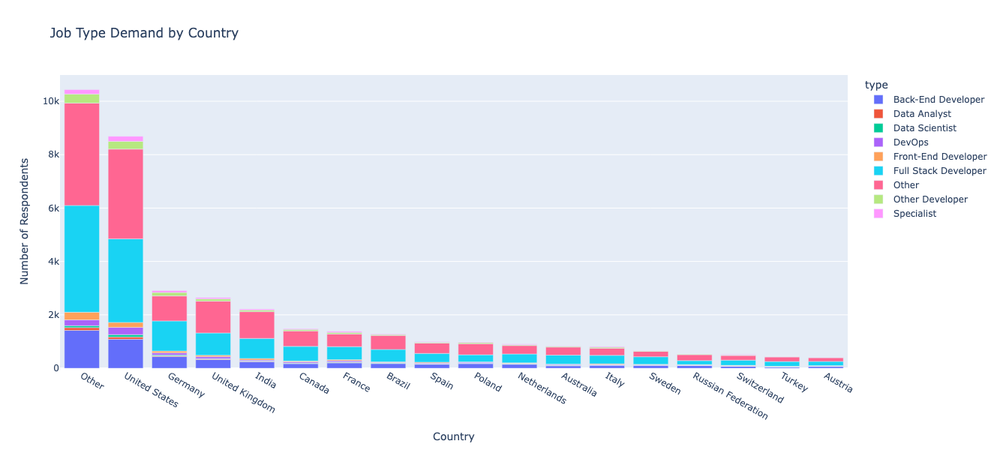

In [17]:
# Count of job types by country
job_type_country = df_22.groupby(['country', 'type']).size().reset_index(name='count')

fig = px.bar(job_type_country, x='country', y='count', color='type', 
             title='Job Type Demand by Country',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

fig.update_layout(xaxis_title='Country', yaxis_title='Number of Respondents', xaxis={'categoryorder':'total descending'})
fig.show()

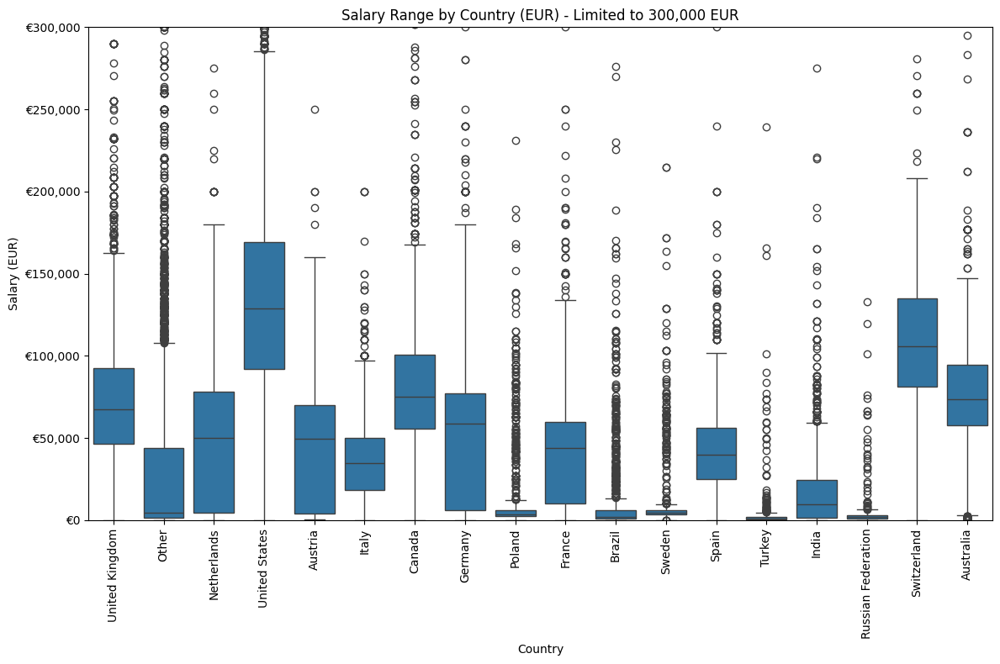

In [18]:
import matplotlib.ticker as mticker

# Set the figure size
plt.figure(figsize=(12, 8))

# Create a box plot for salary range vs country
sns.boxplot(x='country', y='salary_eur', data=df_22)

# Rotate the x-axis labels for better readability
plt.xticks(rotation=90)

# Set the title and labels
plt.title('Salary Range by Country (EUR) - Limited to 300,000 EUR')
plt.xlabel('Country')
plt.ylabel('Salary (EUR)')

# Limit the y-axis to a maximum of 300,000 EUR
plt.ylim(0, 300000)

# Format the y-axis to show proper salary values
plt.gca().yaxis.set_major_formatter(mticker.FuncFormatter(lambda x, _: f'€{x:,.0f}'))

# Show the plot
plt.tight_layout()
plt.show()

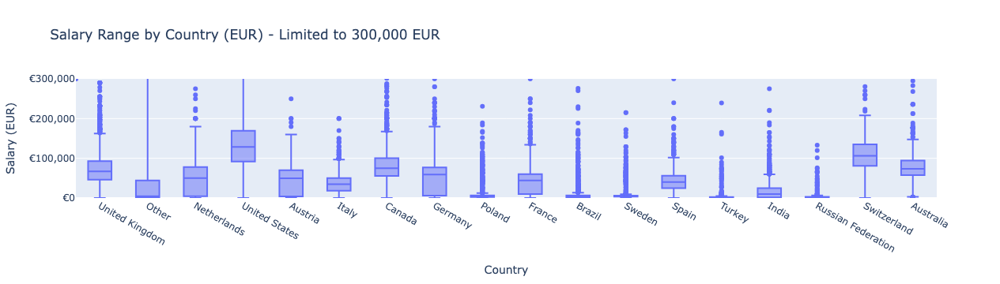

In [19]:
import plotly.express as px

# Create a box plot for salary range vs country
fig = px.box(df_22, x='country', y='salary_eur', 
             title='Salary Range by Country (EUR) - Limited to 300,000 EUR',
             labels={'salary_eur': 'Salary (EUR)', 'country': 'Country'})

# Limit the y-axis to a maximum of 300,000 EUR
fig.update_layout(yaxis=dict(range=[0, 300000]))

# Update y-axis formatting to include proper salary display
fig.update_yaxes(tickprefix='€', tickformat=',.0f')

# Display the plot
fig.show()

In [20]:
# check the salariy column and unusual high max values
# Filter the rows where salary_eur is greater than 300,000
high_salary_df = df_22[df_22['salary_eur'] > 300000][['country', 'currency', 'salary', 'salary_eur']]

# Display the filtered rows
display(high_salary_df, high_salary_df['country'].value_counts())

,country,currency,salary,salary_eur
52,United States,USD,450000.0,414000.0
66,United States,USD,6000000.0,5520000.0
94,United States,USD,400000.0,368000.0
108,Other,EUR,42000044.0,42000044.0
211,United States,USD,350000.0,322000.0
...,...,...,...,...
37798,United States,USD,600000.0,552000.0
37803,United States,USD,450000.0,414000.0
37987,Other,NGN,2600000.0,2600000.0
38071,Other,NGN,2000000.0,2000000.0


country
Other             424
United States     372
United Kingdom     24
Canada             11
Switzerland         6
Germany             6
Australia           6
India               4
Netherlands         3
France              2
Brazil              2
Italy               1
Austria             1
Name: count, dtype: int64

In [21]:
# decided to drop rows where salary_eur exceed 300,000 and focus on where the real range lies
# Drop rows where salary_eur is greater than 300,000
df_22_cleaned = df_22[df_22['salary_eur'] <= 300000]

# Verify the number of rows after filtering
print(df_22_cleaned.shape)

# Display a sample of the cleaned data
print(df_22_cleaned[['country', 'currency', 'salary', 'salary_eur']].head())

(37297, 11)
          country currency    salary  salary_eur
0  United Kingdom      GBP   32000.0     37120.0
1           Other      ILS   60000.0     14400.0
2     Netherlands      EUR   46000.0     46000.0
3  United Kingdom      GBP   48000.0     55680.0
4   United States      USD  194400.0    178848.0


---

# EDA Analysis:

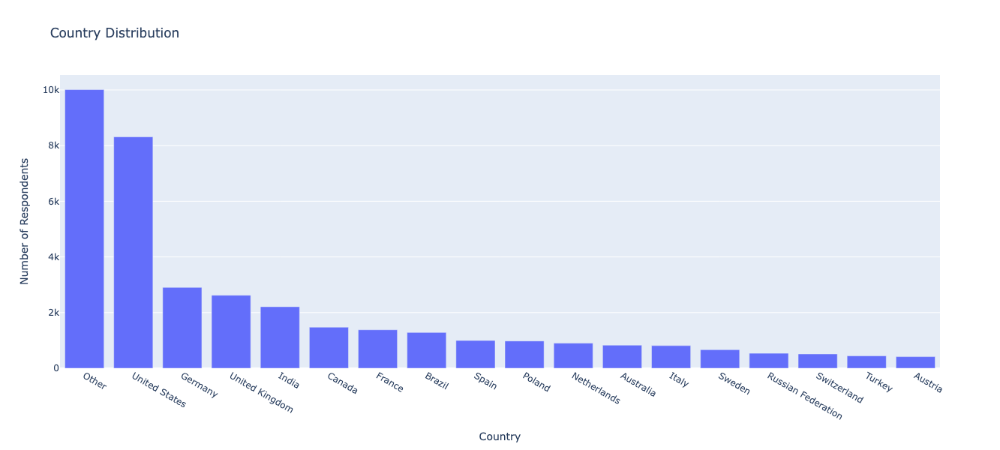

In [22]:
# Get the value counts for the 'country' column
country_distribution = df_22_cleaned['country'].value_counts().reset_index()
country_distribution.columns = ['country', 'count']

# Create a bar chart for country distribution
fig = px.bar(country_distribution, x='country', y='count', 
             title='Country Distribution',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis={'categoryorder':'total descending'}, xaxis_title='Country', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

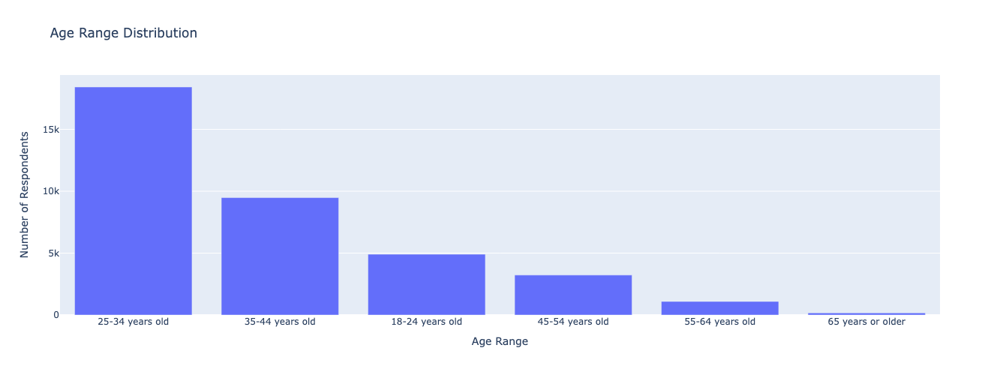

In [23]:
# Get the value counts for the 'age_range' column
age_range_distribution = df_22_cleaned['age_range'].value_counts().reset_index()
age_range_distribution.columns = ['age_range', 'count']

# Create a bar chart for age range distribution
fig = px.bar(age_range_distribution, x='age_range', y='count', 
             title='Age Range Distribution',
             labels={'count': 'Number of Respondents', 'age_range': 'Age Range'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Age Range', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

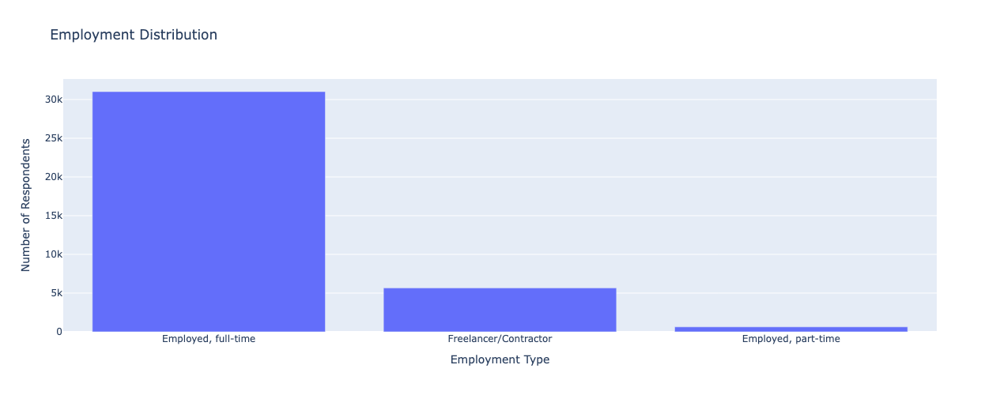

In [24]:
# Get the value counts for the 'employment' column
employment_distribution = df_22_cleaned['employment'].value_counts().reset_index()
employment_distribution.columns = ['employment', 'count']

# Create a bar chart for employment distribution
fig = px.bar(employment_distribution, x='employment', y='count', 
             title='Employment Distribution',
             labels={'count': 'Number of Respondents', 'employment': 'Employment Type'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Employment Type', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

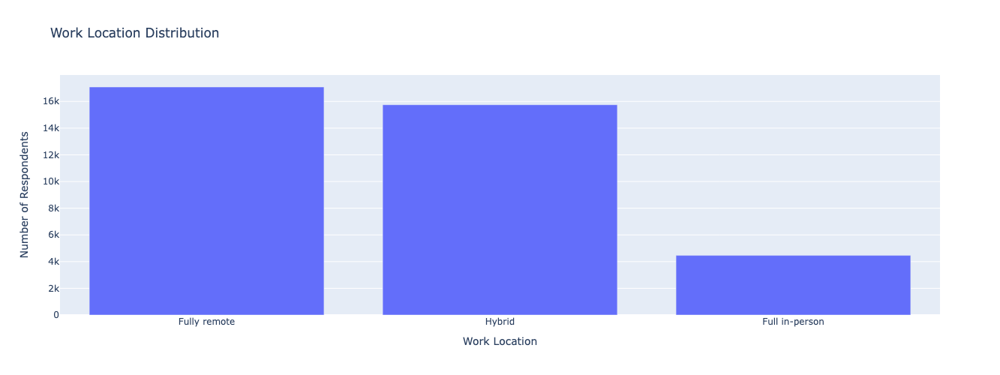

In [25]:
# Get the value counts for the 'work_location' column
work_location_distribution = df_22_cleaned['work_location'].value_counts().reset_index()
work_location_distribution.columns = ['work_location', 'count']

# Create a bar chart for work location distribution
fig = px.bar(work_location_distribution, x='work_location', y='count', 
             title='Work Location Distribution',
             labels={'count': 'Number of Respondents', 'work_location': 'Work Location'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Work Location', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

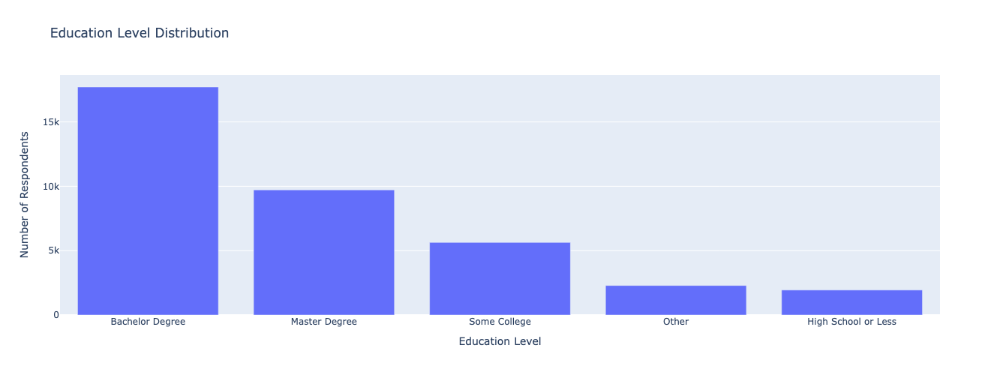

In [26]:
# Get the value counts for the 'education_level' column
education_level_distribution = df_22_cleaned['education_level'].value_counts().reset_index()
education_level_distribution.columns = ['education_level', 'count']

# Create a bar chart for education level distribution
fig = px.bar(education_level_distribution, x='education_level', y='count', 
             title='Education Level Distribution',
             labels={'count': 'Number of Respondents', 'education_level': 'Education Level'},
             width=800, height=500)

# Update layout for better visualization
fig.update_layout(xaxis_title='Education Level', yaxis_title='Number of Respondents')

# Display the plot
fig.show()

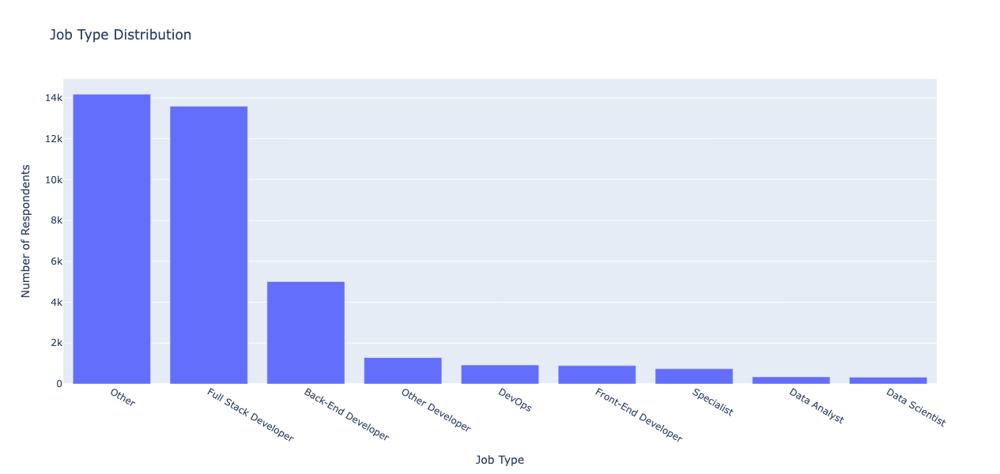

In [27]:
# Get the value counts for the 'type' column
type_distribution = df_22_cleaned['type'].value_counts().reset_index()
type_distribution.columns = ['type', 'count']

# Create a bar chart for type distribution
fig = px.bar(type_distribution, x='type', y='count', 
             title='Job Type Distribution',
             labels={'count': 'Number of Respondents', 'type': 'Job Type'},
             width=1000, height=600)

# Update layout for better visualization
fig.update_layout(xaxis_title='Job Type', yaxis_title='Number of Respondents', 
                  xaxis={'categoryorder':'total descending'})

# Display the plot
fig.show()

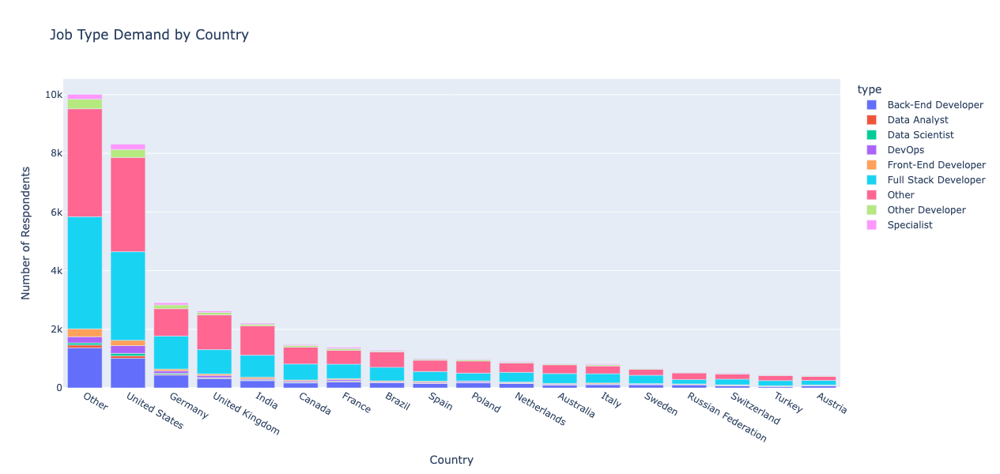

In [28]:
# Count of job types by country
job_type_country = df_22_cleaned.groupby(['country', 'type']).size().reset_index(name='count')

fig = px.bar(job_type_country, x='country', y='count', color='type', 
             title='Job Type Demand by Country',
             labels={'count': 'Number of Respondents', 'country': 'Country'},
             width=1000, height=600)

fig.update_layout(xaxis_title='Country', yaxis_title='Number of Respondents', xaxis={'categoryorder':'total descending'})
fig.show()

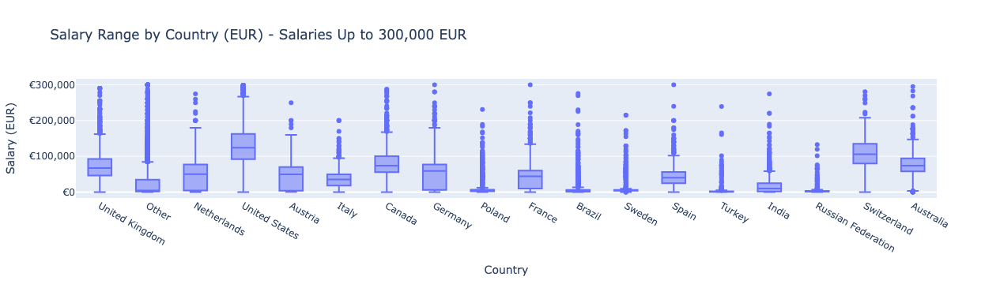

In [29]:
# Create a box plot for salary range vs country using the cleaned data
fig = px.box(df_22_cleaned, x='country', y='salary_eur', 
             title='Salary Range by Country (EUR) - Salaries Up to 300,000 EUR',
             labels={'salary_eur': 'Salary (EUR)', 'country': 'Country'})

# Update y-axis formatting to include proper salary display
fig.update_yaxes(tickprefix='€', tickformat=',.0f')

# Display the plot
fig.show()

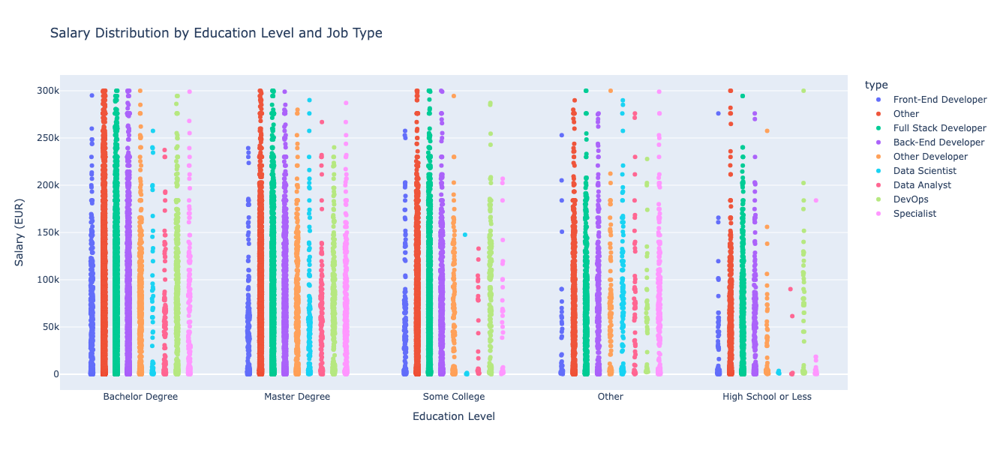

In [30]:
fig = px.strip(df_22_cleaned, x='education_level', y='salary_eur', color='type', 
               title='Salary Distribution by Education Level and Job Type',
               labels={'salary_eur': 'Salary (EUR)', 'education_level': 'Education Level'},
               hover_data=['type'],
               width=1000, height=600)

fig.update_layout(xaxis_title='Education Level', yaxis_title='Salary (EUR)', xaxis={'categoryorder':'total descending'})
fig.show()

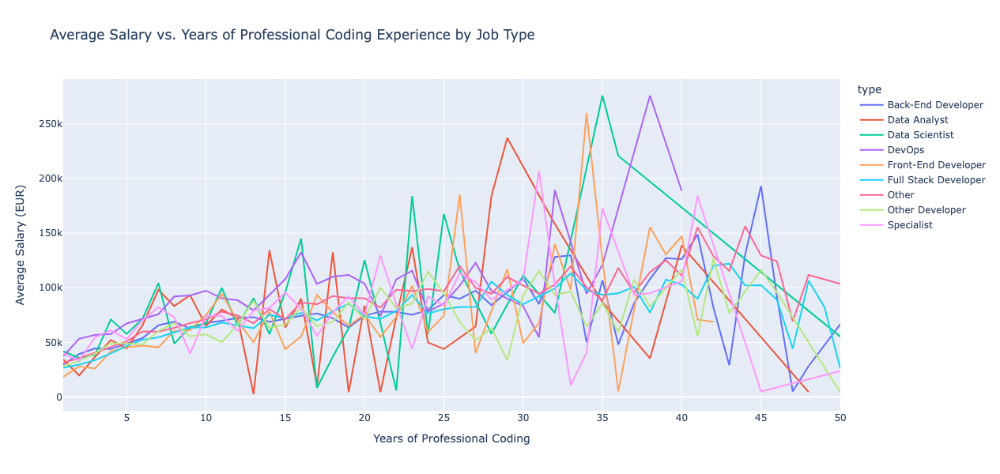

In [31]:
# Group by years of coding and job type to get average salary
salary_experience = df_22_cleaned.groupby(['years_coding_pro', 'type'])['salary_eur'].mean().reset_index()

fig = px.line(salary_experience, x='years_coding_pro', y='salary_eur', color='type', 
              title='Average Salary vs. Years of Professional Coding Experience by Job Type',
              labels={'salary_eur': 'Average Salary (EUR)', 'years_coding_pro': 'Years of Professional Coding'},
              width=1000, height=600)

fig.update_layout(xaxis_title='Years of Professional Coding', yaxis_title='Average Salary (EUR)')
fig.show()

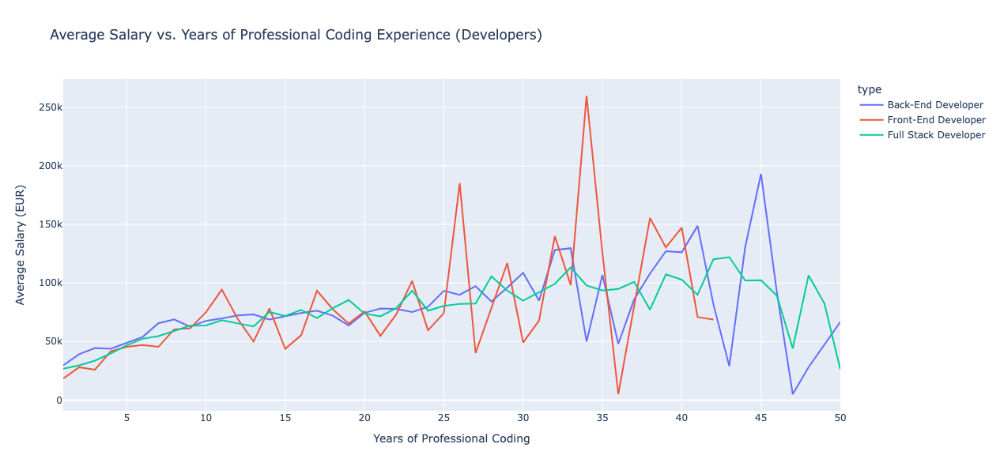

In [32]:
# Define the job types for developers
developer_types = ['Full Stack Developer', 'Back-End Developer', 'Front-End Developer']

# Filter the dataset for developers
developer_salary_experience = df_22_cleaned[df_22_cleaned['type'].isin(developer_types)]

# Group by years of coding and job type to get average salary for developers
developer_salary_experience = developer_salary_experience.groupby(['years_coding_pro', 'type'])['salary_eur'].mean().reset_index()

# Plot the graph for developers
fig = px.line(developer_salary_experience, x='years_coding_pro', y='salary_eur', color='type', 
              title='Average Salary vs. Years of Professional Coding Experience (Developers)',
              labels={'salary_eur': 'Average Salary (EUR)', 'years_coding_pro': 'Years of Professional Coding'},
              width=1000, height=600)

fig.update_layout(xaxis_title='Years of Professional Coding', yaxis_title='Average Salary (EUR)')
fig.show()

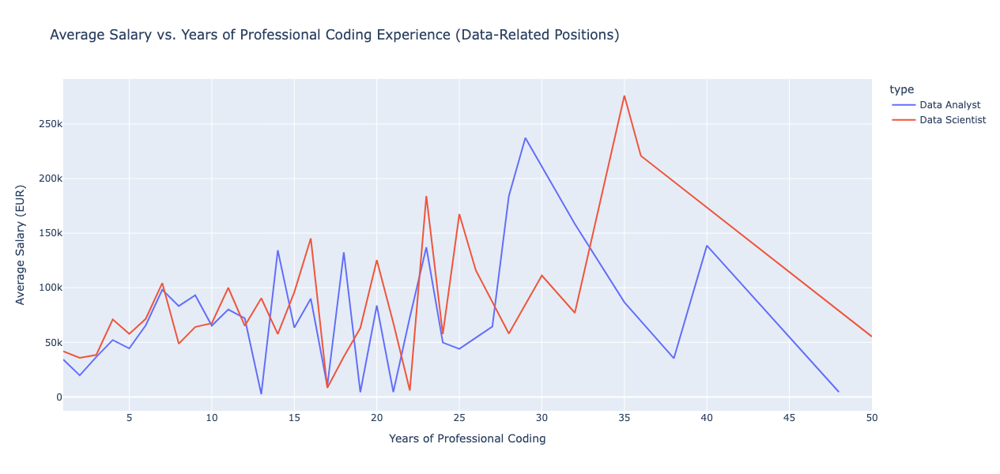

In [33]:
# Define the job types for data-related positions
data_related_types = ['Data Scientist', 'Data Engineer', 'Data Analyst', 'Machine Learning Specialist']

# Filter the dataset for data-related positions
data_salary_experience = df_22_cleaned[df_22_cleaned['type'].isin(data_related_types)]

# Group by years of coding and job type to get average salary for data-related positions
data_salary_experience = data_salary_experience.groupby(['years_coding_pro', 'type'])['salary_eur'].mean().reset_index()

# Plot the graph for data-related positions
fig = px.line(data_salary_experience, x='years_coding_pro', y='salary_eur', color='type', 
              title='Average Salary vs. Years of Professional Coding Experience (Data-Related Positions)',
              labels={'salary_eur': 'Average Salary (EUR)', 'years_coding_pro': 'Years of Professional Coding'},
              width=1000, height=600)

fig.update_layout(xaxis_title='Years of Professional Coding', yaxis_title='Average Salary (EUR)')
fig.show()

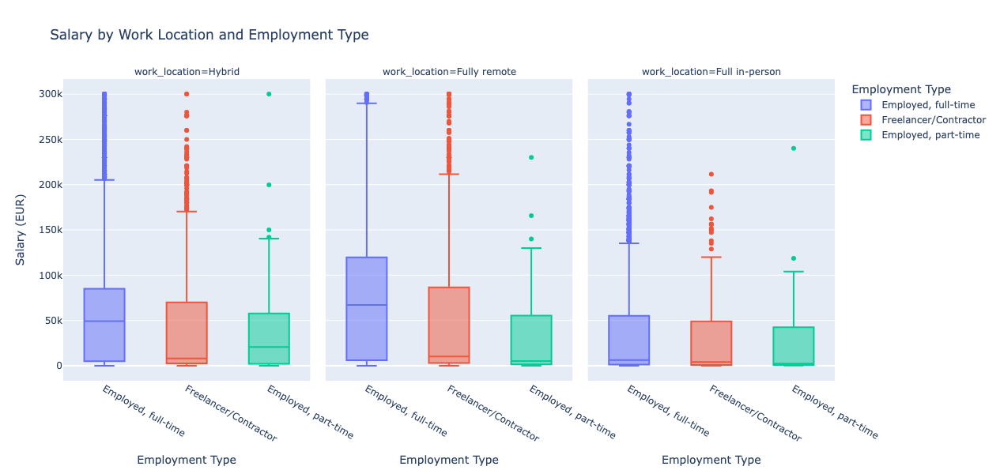

In [34]:
fig = px.box(df_22_cleaned, x='employment', y='salary_eur', color='employment',
             facet_col='work_location', title='Salary by Work Location and Employment Type',
             labels={'salary_eur': 'Salary (EUR)', 'employment': 'Employment Type'},
             width=1000, height=600)

fig.update_layout(xaxis_title='Employment Type', yaxis_title='Salary (EUR)')
fig.show()

In [35]:
# Make a copy of the cleaned table
df_22_cleaned.to_csv('final_df_22.csv', index=False)